# Práctica 6 - Eigen Faces
Aprendizaje de máquina para visión computacional 2024-2

Integrantes:

- Alejandro Mendoza Puig
- Naomi Itzel Reyes Granados
- Victor Hernández Díaz

Realizar la practica  Eigenfaces. Siguiendo la liga que se muestra ahi, vaya a la pagina donde se ve el procesamiento de Eigenfaces, baje las imágenes de Eigenfaces.

Realizar el proceso hasta antes de Face Detection. Para realizar la practica utilice la siguiente  liga que se mostro en clase:
https://sandipanweb.wordpress.com/2018/01/06/eigenfaces-and-a-simple-face-detector-with-pca-svd-in-python/



## Objetivos:
1. Proyección de cada una de las caras de los integrantes del equipo aumentando el numero de eigenfaces, llegue hasta que pueda reconocer su rostro y diga cuantos eigenfaces utilizo. Averigue como realizar este proceso de proyección-reconstrucción.

2. Realice la parte de Face Morphing, la cual  es muy sencillo de implementar si se tiene la parte de reconstrucción anterior. Hacer face morphin usando 1 de las caras de los integrantes del equipo.


## Introducción:



### Procedimiento para la obtención de los Eigen-Faces (PCA):

1.   Estadarizamos el tamaño de todas las imagenes.

2.   Calculemos la imagen "promedio" obtenida restando a la imagen original la media de los píxeles de todas las imagenes.

3. Aplanamos la imagen anterior para obtener su representación en un vector $1D$.

4. Generamos una matriz $2D$ que contenga a todas las imagenes del paso anterior.

5. Aplicamos $SVD$ para encontrar los valores propios de la matriz definida anteriormente y con ello los vectores propios; solo nos quedamos con los $k$ vectores propios correspondinetes a los $k$ valores propios más grandes y estos serán nuestros eigen-faces.

### Represnetación de Imagenes:

Dados los $k$ eigen-faces calculadas ateriormente podemos podemos representar cualquier imagen como una una combinación lineal de dichas eigen-faces. Para esto, primero tenemos que preprocesar la imagen aplicando los primeros $3$ puntos del procedimiento pasado. Ya que obtenemos el vector $1D$ que represnete a la nueva imagen calculamos sus productos punto con cada uno de los eigenvectores (eigen-faces). El resultado son los coeficientes (pesos) que representan la nueva imagen como una combinación lineal de las eigen-faces.


In [1]:
## Repositorio
! git clone https://github.com/diazhv/mlcv2024-2.git

Clonando en 'mlcv2024-2'...
remote: Enumerating objects: 6239, done.
remote: Counting objects: 100% (1887/1887), done.
remote: Compressing objects: 100% (1865/1865), done.
remote: Total 6239 (delta 32), reused 1868 (delta 21), pack-reused 4352
Recibiendo objetos: 100% (6239/6239), 151.22 MiB | 12.88 MiB/s, listo.
Resolviendo deltas: 100% (3288/3288), listo.
Actualizando archivos: 100% (6495/6495), listo.


In [2]:
import sys
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os


In [3]:
def lista_archivos(path,ext_file='.tif'):
    '''
    Esta función busca dentro de un directorio especificado todas las capas con extensión **.$$$**
    y regresa una lista con la ruta de cada una de ellas.

    :param path: ruta del direcctorio que contiene las capas shape
    :type path: str

    :returns: lista con la ruta de cada capa localizada en el directorio y subdirectorios
    :rtype: list
    '''
    lista_shp=[]
    lista_names = []
    for root, dirs, files in os.walk(path):
        for name in files:
            extension = os.path.splitext(name)
            if extension[1] == ext_file:
                ruta = (root.replace("\\","/")+"/").replace("//","/")+name
                lista_names.append(name.replace(ext_file,''))
                lista_shp.append(ruta)
    return lista_shp

def l_array_imgs(path,ext=".pgm"):
  lista = lista_archivos(path,ext)
  l_imgs = []
  for p_i in lista:
    img = cv2.imread(p_i)
    if len(img.shape)>2:
      l_imgs.append(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY))
    else:
      l_imgs.append(img)
  print(f'Total de imagenes encontradas: {len(lista)}')
  return l_imgs


In [4]:
path_imgs = 'lfw1000/'

images = l_array_imgs(path_imgs,ext=".pgm")

test = l_array_imgs(path_imgs,ext=".jpg")


Total de imagenes encontradas: 1071
Total de imagenes encontradas: 3


In [5]:
min_rows, min_cols = 64,64
max_rows, max_cols = 64,64
m = len(images)
d = min_rows * min_cols
X = np.reshape(images, (m, d))

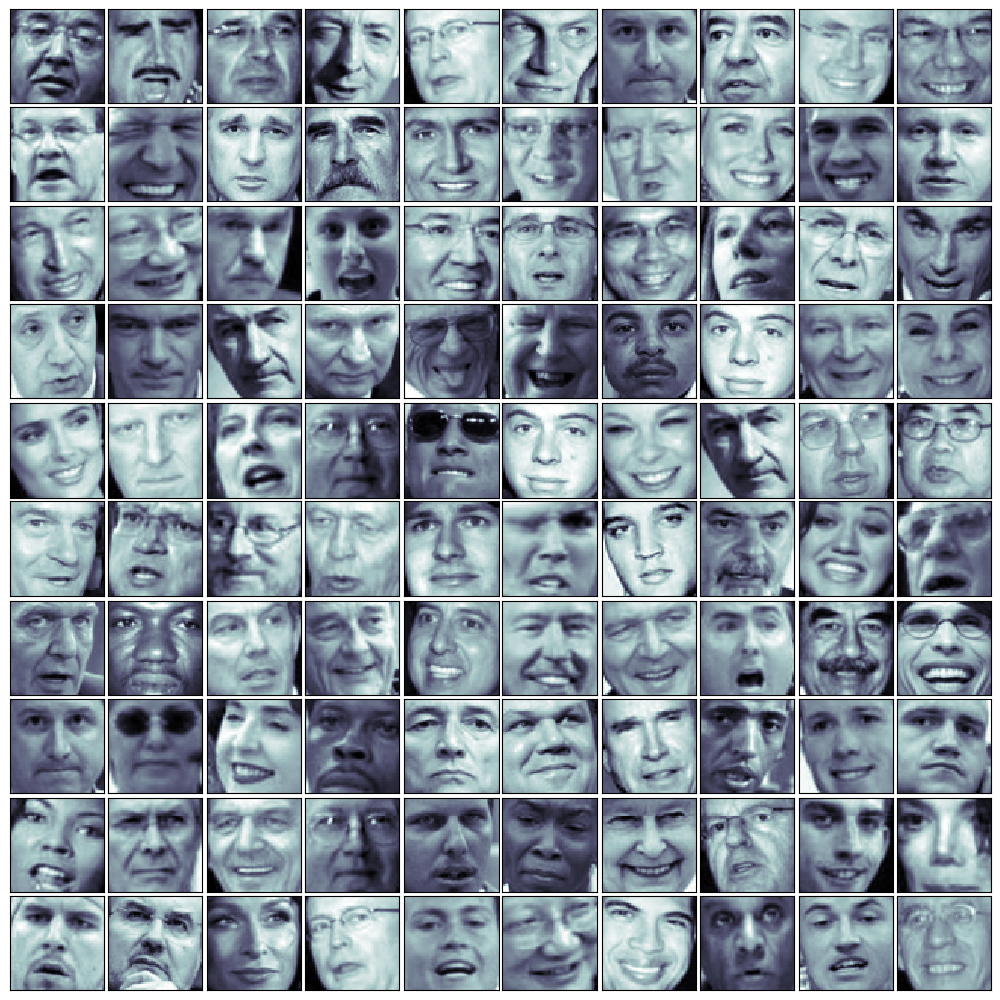

In [6]:
fig = plt.figure(figsize=(10,10))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
j = 1
np.random.seed(23)
for i in np.random.choice(range(X.shape[0]), 100):
    ax = fig.add_subplot(10, 10, j, xticks=[], yticks=[])
    ax.imshow(np.reshape(X[i,:],(64,64)), cmap=plt.cm.bone, interpolation='nearest')
    j += 1
plt.show()

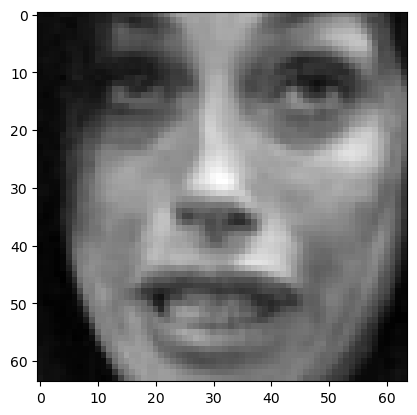

In [7]:
plt.imshow(np.reshape(X[int(len(X)/2), :], (min_rows, min_cols)),cmap='gray')

In [8]:
U, Sigma, VT = np.linalg.svd(X, full_matrices=False)
# Sanity check on dimensions
print("X:", X.shape)
print("U:", U.shape)
print("Sigma:", Sigma.shape)
print("V^T:", VT.shape)

X: (1071, 4096)
U: (1071, 1071)
Sigma: (1071,)
V^T: (1071, 4096)


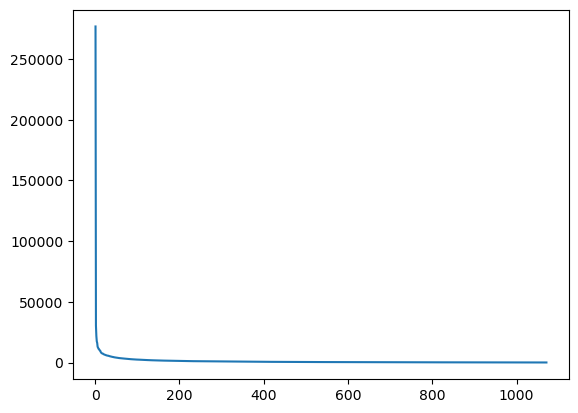

In [9]:
plt.plot([i for i in range(1,len(Sigma)+1)],Sigma)

(1071, 1071)


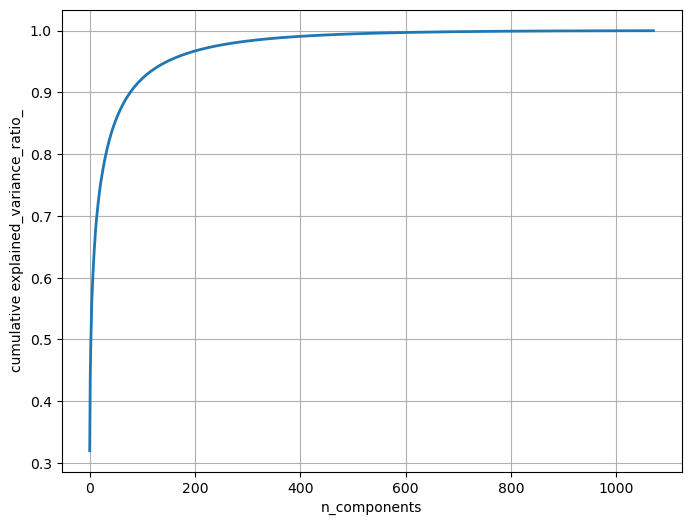

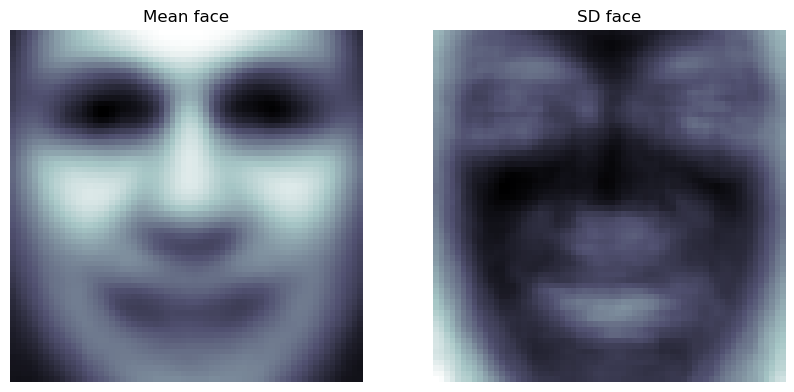

In [32]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
import pylab

n_comp =1071
pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_comp))])
faces_proj = pipeline.fit_transform(X)
print(faces_proj.shape)
mean_face = np.reshape(pipeline.named_steps['scaling'].mean_, (64,64))
sd_face = np.reshape(np.sqrt(pipeline.named_steps['scaling'].var_), (64,64))
pylab.figure(figsize=(8, 6))
pylab.plot(np.cumsum(pipeline.named_steps['pca'].explained_variance_ratio_), linewidth=2)
pylab.grid(), pylab.axis('tight'), pylab.xlabel('n_components'), pylab.ylabel('cumulative explained_variance_ratio_')
pylab.show()
pylab.figure(figsize=(10,5))
pylab.subplot(121), pylab.imshow(mean_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('Mean face')
pylab.subplot(122), pylab.imshow(sd_face, cmap=pylab.cm.bone), pylab.axis('off'), pylab.title('SD face')
pylab.show()

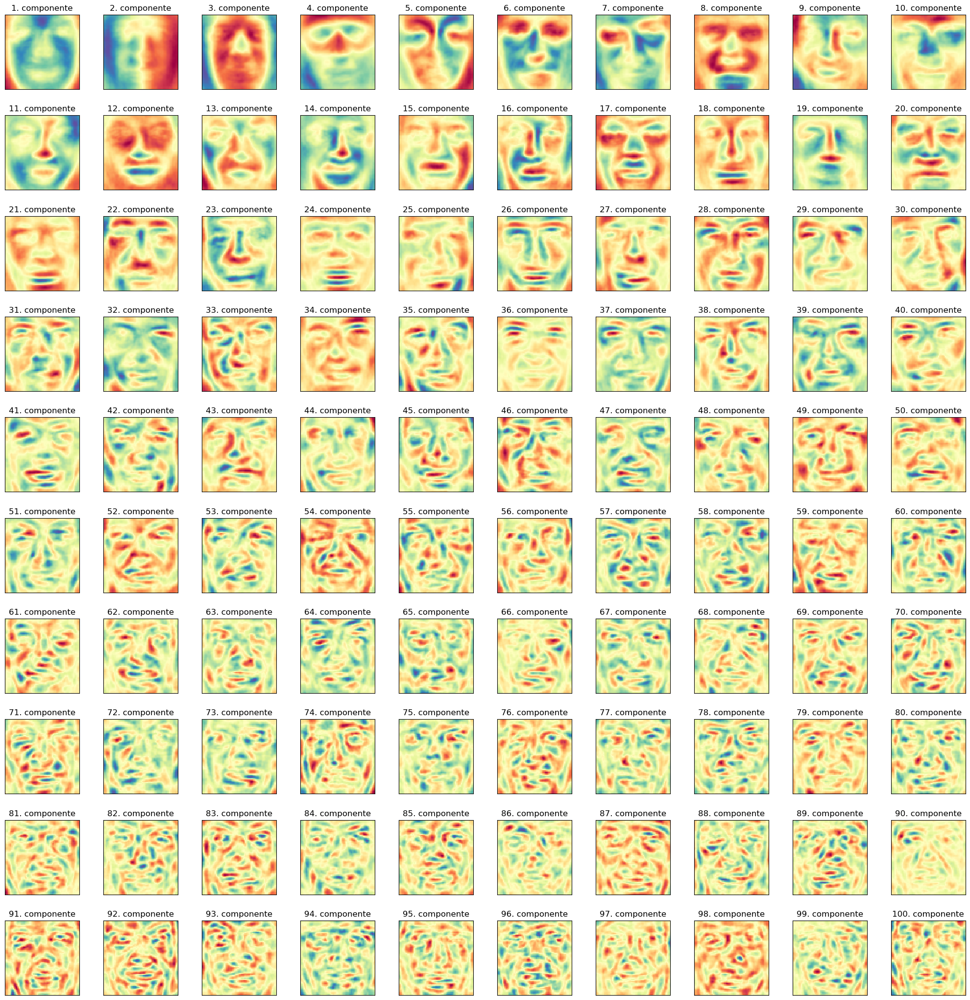

In [11]:
fig = plt.figure(figsize=(20,20))
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.35, wspace=0.05)
# plot the first 10 eigenfaces
for i in range(100):
    ax = fig.add_subplot(10, 10, i+1, xticks=[], yticks=[])
    ax.imshow(np.reshape(pipeline.named_steps['pca'].components_[i,:], (64,64)), cmap="Spectral", interpolation='nearest')
    ax.set_title(f"{i+1}. componente")

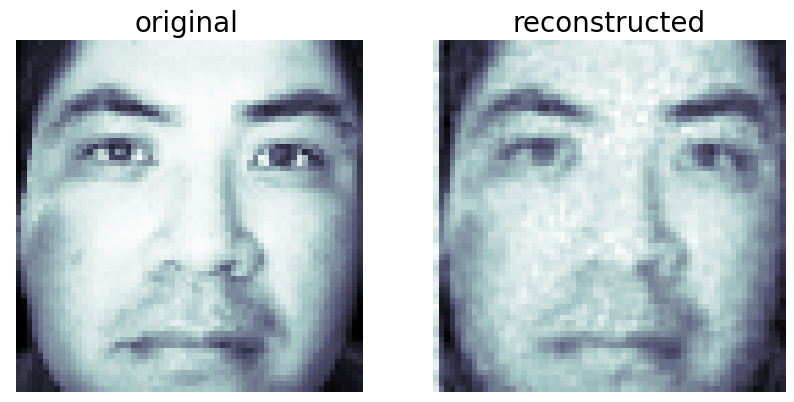

In [34]:
## Reconstruir con los eigen faces
faces_proj = pipeline.transform(test[2].reshape(1, d))

orig_face = test[2]
reconst_face = np.reshape(faces_proj[-1,:][:1000]@pipeline.named_steps['pca'].components_[:1000,:], (64,64))
reconst_face = mean_face +sd_face* reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()


In [ ]:
import imageio
from PIL import Image
resultados = []
fig = plt.figure(figsize=(10,5))
plt.imshow(mean_face, cmap=plt.cm.bone, interpolation='nearest')
plt.axis('off')
plt.title('mean face', size=20)
plt.savefig("resultados/componente_0.png")
fig_c = Image.open("resultados/"+f'componente_{0}'+".png")
resultados.append(fig_c)

for i in range(2,401):

    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("resultados/"+f'componente_{i}'+".png")
    fig_c = Image.open("resultados/"+f'componente_{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('resultados/reproyeccion_vhd.gif', format="GIF", append_images=resultados,
               save_all=True, duration=100, loop=1)


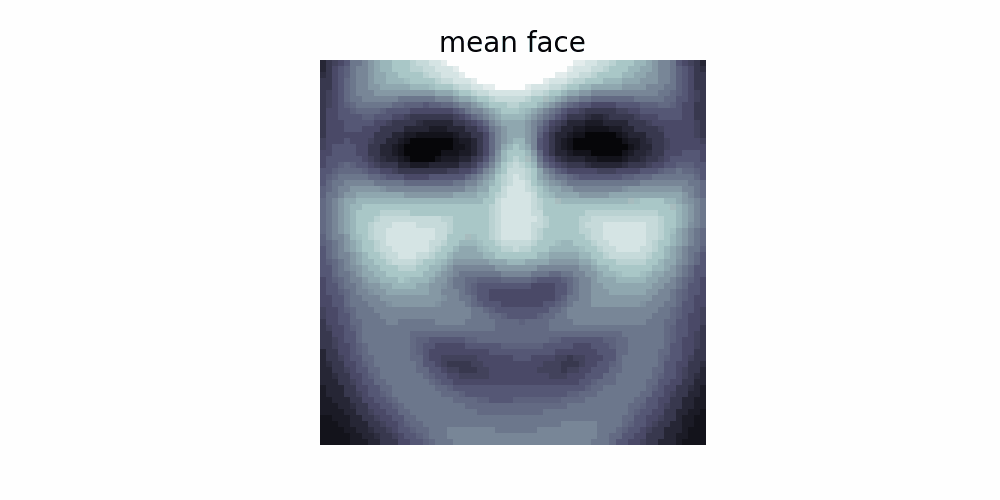

In [25]:
from IPython.display import Image
Image(open('resultados/reproyeccion_vhd.gif','rb').read())

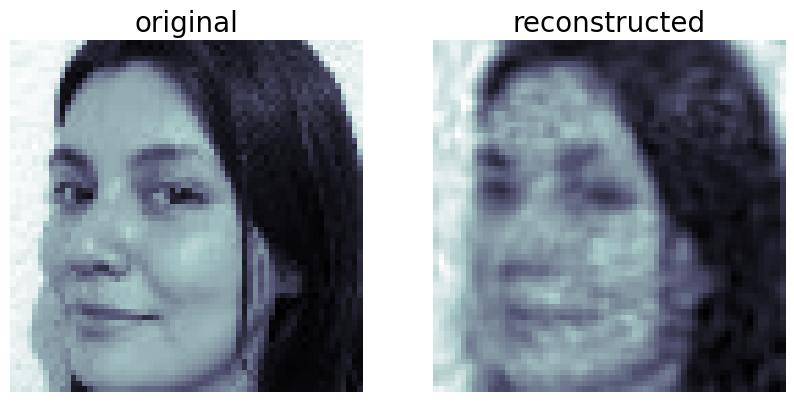

In [15]:
## Reconstruir con los eigen faces

faces_proj = pipeline.transform(test[1].reshape(1, d))

orig_face = test[1]
reconst_face = np.reshape(faces_proj[-1,:][:400]@pipeline.named_steps['pca'].components_[:400,:], (64,64))
reconst_face = mean_face + sd_face* reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()


In [ ]:

import imageio
from PIL import Image
resultados = []
fig = plt.figure(figsize=(10,5))
plt.imshow(mean_face, cmap=plt.cm.bone, interpolation='nearest')
plt.axis('off')
plt.title('mean face', size=20)
plt.savefig("resultados/componente_0.png")
fig_c = Image.open("resultados/"+f'componente_{0}'+".png")
resultados.append(fig_c)

for i in range(2,401):

    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("resultados/"+f'componente_{i}'+".png")
    fig_c = Image.open("resultados/"+f'componente_{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('resultados/reproyeccion_naomi.gif', format="GIF", append_images=resultados,
               save_all=True, duration=100, loop=1)


![](mlcv2024-2/practicas/practica06/resultados/reproyeccion.gif)

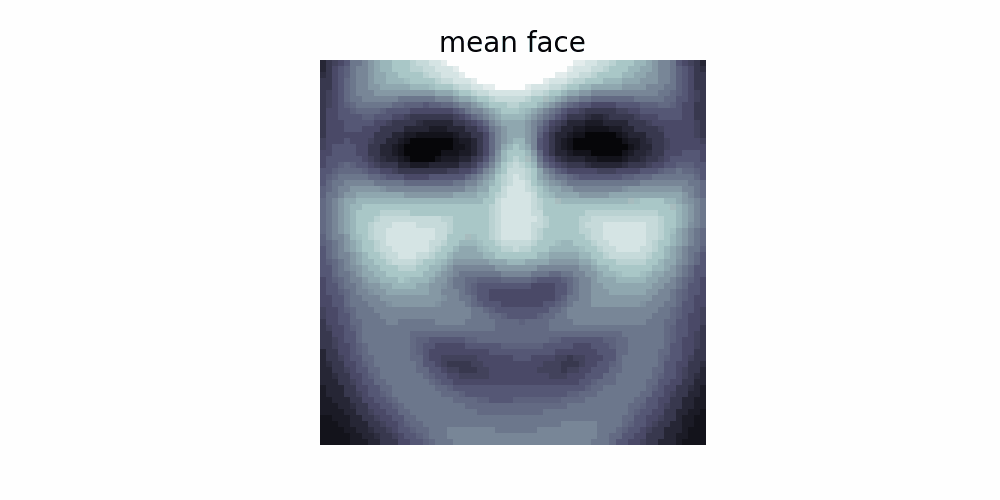

In [17]:
from IPython.display import Image
Image(open('resultados/reproyeccion_naomi.gif','rb').read())

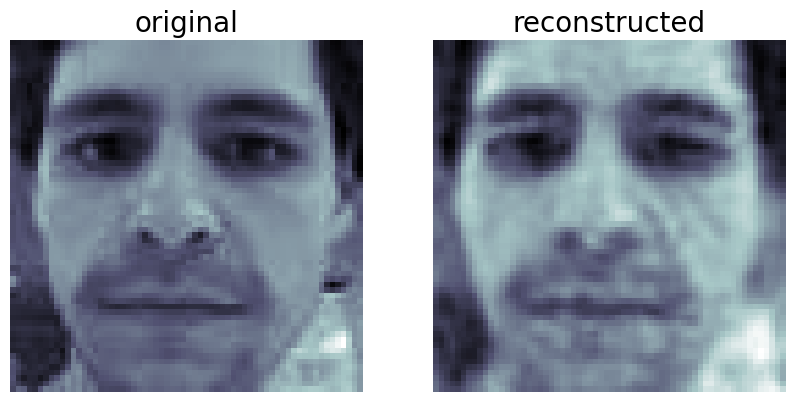

In [18]:
## Reconstruir con los eigen faces

faces_proj = pipeline.transform(test[0].reshape(1, d))

orig_face = test[0]
reconst_face = np.reshape(faces_proj[-1,:][:400]@pipeline.named_steps['pca'].components_[:400,:], (64,64))
reconst_face = mean_face + sd_face* reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()

In [ ]:
import imageio
from PIL import Image
resultados = []
fig = plt.figure(figsize=(10,5))
plt.imshow(mean_face, cmap=plt.cm.bone, interpolation='nearest')
plt.axis('off')
plt.title('mean face', size=20)
plt.savefig("resultados/componente_0.png")
fig_c = Image.open("resultados/"+f'componente_{0}'+".png")
resultados.append(fig_c)

for i in range(2,401):

    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("resultados/"+f'componente_{i}'+".png")
    fig_c = Image.open("resultados/"+f'componente_{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('resultados/reproyeccion_alex.gif', format="GIF", append_images=resultados,
               save_all=True, duration=100, loop=1)

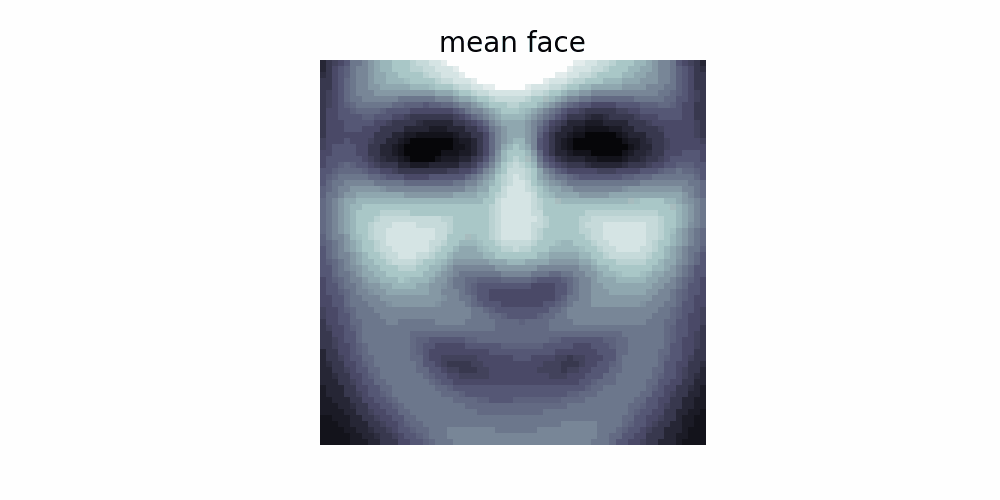

In [20]:
from IPython.display import Image
Image(open('resultados/reproyeccion_alex.gif','rb').read())

# Face Morphing

In [ ]:
from PIL import Image

resultados = []

faces_proj = pipeline.transform(test[2].reshape(1, d))

for i in range(400,50,-1):
    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("resultado_morph/"+f'componente_{i}'+".png")
    fig_c = Image.open("resultado_morph/"+f'componente_{i}'+".png")
    resultados.append(fig_c)

faces_proj = pipeline.transform(test[0].reshape(1, d))

for i in range(50, 400, 1):
    reconst_face = np.reshape(faces_proj[-1,:][:i]@pipeline.named_steps['pca'].components_[:i,:], (64,64))
    reconst_face = mean_face + sd_face*reconst_face
    fig = plt.figure(figsize=(10,5))
    plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest')
    plt.axis('off')
    plt.title(f'componente {i}', size=20)
    plt.savefig("resultado_morph/"+f'componente_destino{i}'+".png")
    fig_c = Image.open("resultado_morph/"+f'componente_destino{i}'+".png")
    resultados.append(fig_c)


frame_one = resultados[0]
frame_one.save('resultado_morph/morphing.gif', format="GIF", append_images=resultados,
               save_all=True, duration=10, loop=1)

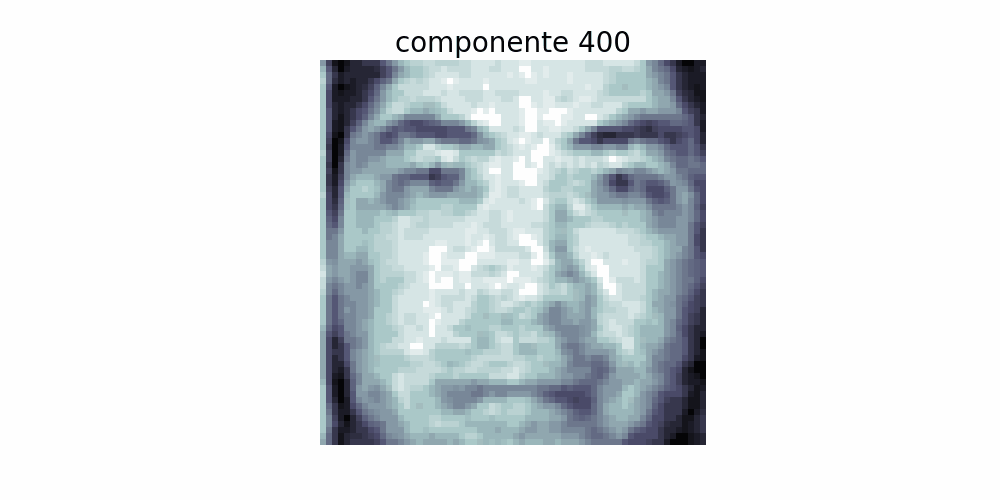

In [35]:
from IPython.display import Image
Image(open('resultado_morph/morphing.gif','rb').read())

## Referencias

Dey, S. (2018). EigenFaces and A simple Face Deterctor with PCA/SVD in python. https://sandipanweb.wordpress.com/2018/01/06/eigenfaces-and-a-simple-face-detector-with-pca-svd-in-python/

Dey, S. (2018). Hands-On Image Processing with Python: Expert Techniques for Advanced Image Analysis and Effective Interpretation of Image Data. Reino Unido: Packt Publishing.